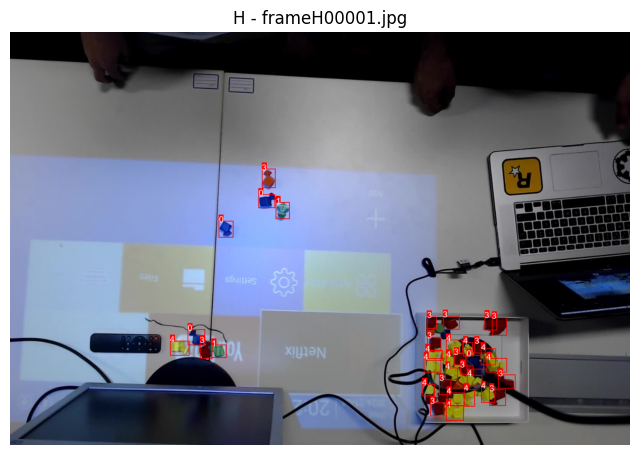

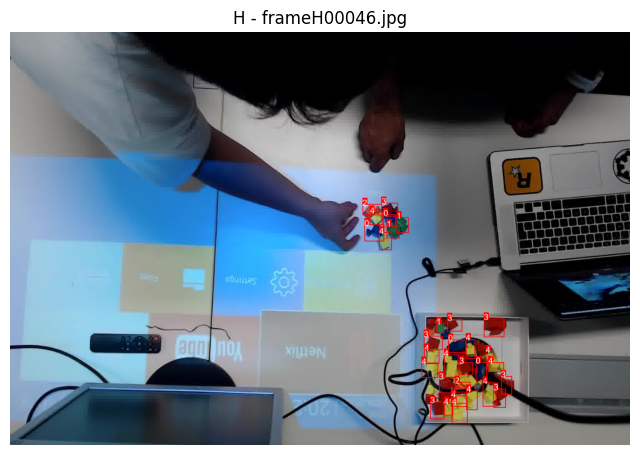

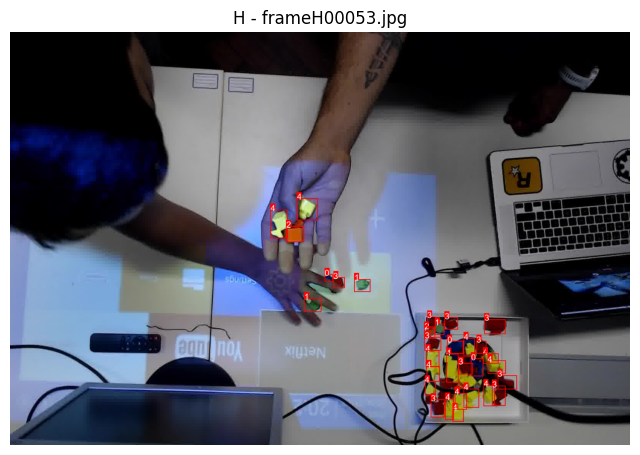

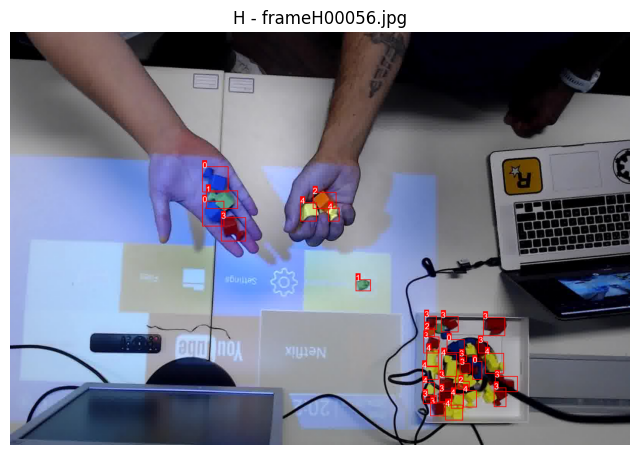

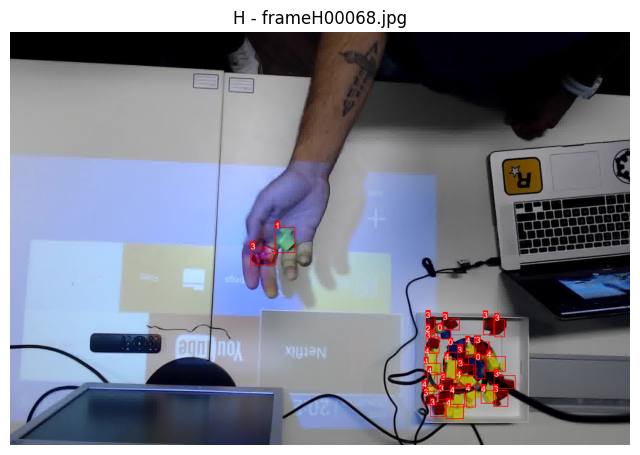

...

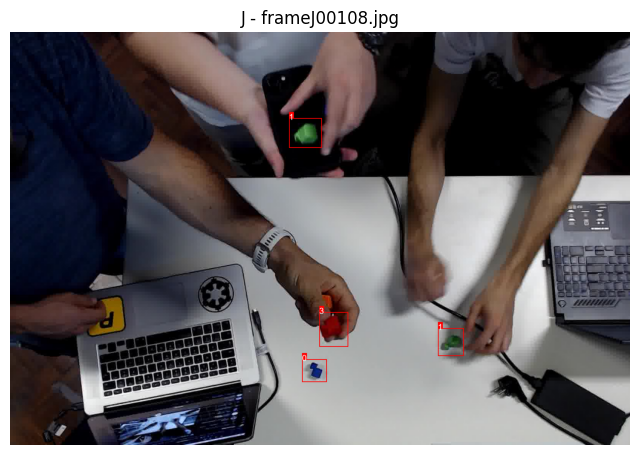

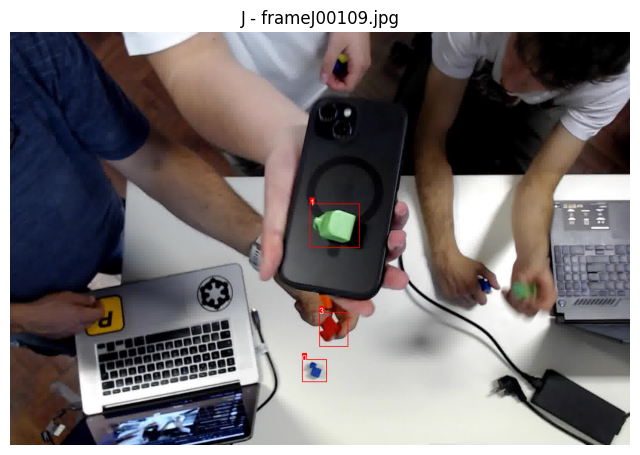

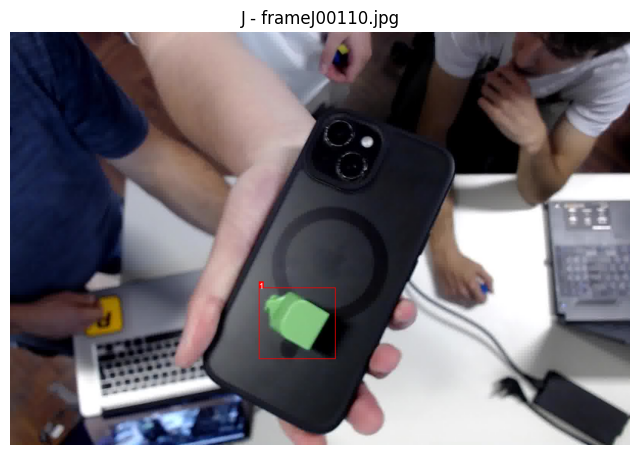

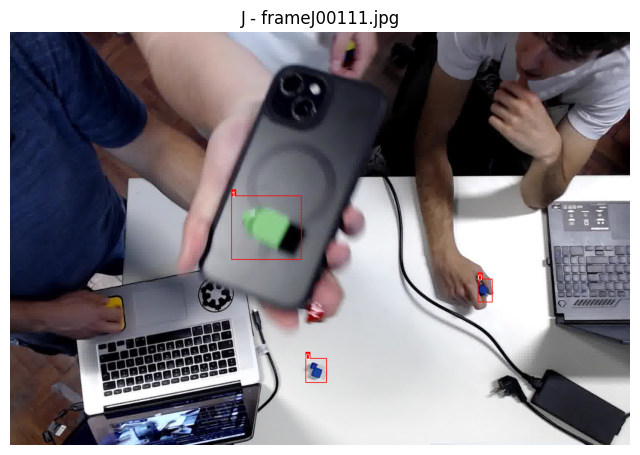

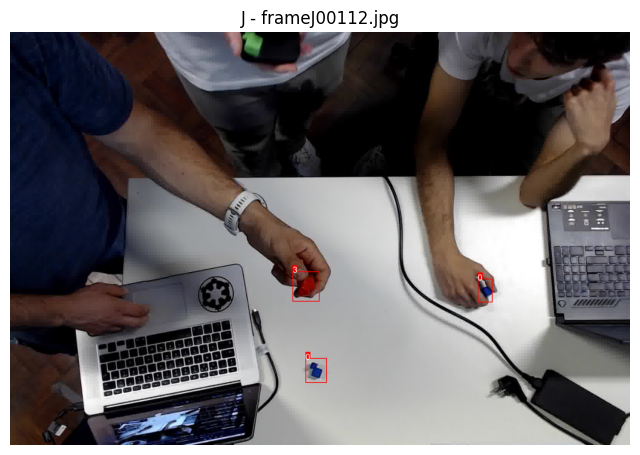

In [ ]:
import os
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt

# Base paths
base_path = "../../data/new_data"
frames_root = os.path.join(base_path, "frames")
annotations_root = os.path.join(base_path, "annotations")

# Try to load a font, fallback to default
try:
    font = ImageFont.truetype("arial.ttf", size=22)
except:
    font = ImageFont.load_default()


def draw_boxes(image_path, annotation_path):
    image = Image.open(image_path).convert("RGB")
    draw = ImageDraw.Draw(image)
    width, height = image.size

    try:
        with open(annotation_path, "r") as file:
            for line in file:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                class_id, x_center, y_center, w, h = map(float, parts)

                # Convert from YOLO format to pixel coordinates
                x_center *= width
                y_center *= height
                w *= width
                h *= height
                x0 = x_center - w / 2
                y0 = y_center - h / 2
                x1 = x_center + w / 2
                y1 = y_center + h / 2

                # Draw rectangle
                draw.rectangle([x0, y0, x1, y1], outline="red", width=2)

                # Add class label
                label = str(int(class_id))
                text_size = draw.textbbox((0, 0), label, font=font)
                text_width = text_size[2] - text_size[0]
                text_height = text_size[3] - text_size[1]

                # Background rectangle for text
                draw.rectangle([x0, y0 - text_height, x0 + text_width, y0], fill="red")
                draw.text((x0, y0 - text_height), label, fill="white", font=font)

    except FileNotFoundError:
        print(f"Annotation not found: {annotation_path}")

    return image


# Display all images with annotations
for subfolder in ["H", "J"]:
    frames_folder = os.path.join(frames_root, subfolder)
    annotations_folder = os.path.join(annotations_root, subfolder)

    for filename in os.listdir(frames_folder):
        if filename.endswith(".jpg"):
            frame_path = os.path.join(frames_folder, filename)
            annotation_path = os.path.join(
                annotations_folder, filename.replace(".jpg", ".txt")
            )

            annotated_image = draw_boxes(frame_path, annotation_path)

            plt.figure(figsize=(8, 6))
            plt.title(f"{subfolder} - {filename}")
            plt.imshow(annotated_image)
            plt.axis("off")
            plt.show()